### Importing packages and functions

In [1]:
from fastai.vision.all import *
from nbdev.showdoc import *
from ipywidgets import widgets

In [2]:
def search_images_ddg(key,max_n=200):
     """Search for 'key' with DuckDuckGo and return a unique urls of 'max_n' images
        (Adopted from https://github.com/deepanprabhu/duckduckgo-images-api)
     """
     url        = 'https://duckduckgo.com/'
     params     = {'q':key}
     res        = requests.post(url,data=params)
     searchObj  = re.search(r'vqd=([\d-]+)\&',res.text)
     if not searchObj: print('Token Parsing Failed !'); return
     requestUrl = url + 'i.js'
     headers    = {'User-Agent': 'Mozilla/5.0 (X11; Ubuntu; Linux x86_64; rv:71.0) Gecko/20100101 Firefox/71.0'}
     params     = (('l','us-en'),('o','json'),('q',key),('vqd',searchObj.group(1)),('f',',,,'),('p','1'),('v7exp','a'))
     urls       = []
     while True:
         try:
             res  = requests.get(requestUrl,headers=headers,params=params)
             data = json.loads(res.text)
             for obj in data['results']:
                 urls.append(obj['image'])
                 max_n = max_n - 1
                 if max_n < 1: return L(set(urls))     # dedupe
             if 'next' not in data: return L(set(urls))
             requestUrl = url + data['next']
         except:
             pass

In [3]:
from ipywidgets import HBox,VBox,widgets,Button,Checkbox,Dropdown,Layout,Box,Output,Label,FileUpload

@patch
def __getitem__(self:Box, i): return self.children[i]

def widget(im, *args, **layout):
    "Convert anything that can be `display`ed by IPython into a widget"
    o = Output(layout=merge(*args, layout))
    with o: display(im)
    return o

def _update_children(change):
    for o in change['owner'].children:
        if not o.layout.flex: o.layout.flex = '0 0 auto'

def carousel(children=(), **layout):
    "A horizontally scrolling carousel"
    def_layout = dict(overflow='scroll hidden', flex_flow='row', display='flex')
    res = Box([], layout=merge(def_layout, layout))
    res.observe(_update_children, names='children')
    res.children = children
    return res

def _open_thumb(fn, h, w): return Image.open(fn).to_thumb(h, w).convert('RGBA')

class ImagesCleaner:
    "A widget that displays all images in `fns` along with a `Dropdown`"
    def __init__(self, opts=(), height=128, width=256, max_n=30):
        opts = ('<Keep>', '<Delete>')+tuple(opts)
        store_attr('opts,height,width,max_n')
        self.widget = carousel(width='100%')

    def set_fns(self, fns):
        self.fns = L(fns)[:self.max_n]
        ims = parallel(_open_thumb, self.fns, h=self.height, w=self.width, progress=False,
                       n_workers=min(len(self.fns)//10,defaults.cpus))
        self.widget.children = [VBox([widget(im, height=f'{self.height}px'), Dropdown(
            options=self.opts, layout={'width': 'max-content'})]) for im in ims]

    def _ipython_display_(self): display(self.widget)
    def values(self): return L(self.widget.children).itemgot(1).attrgot('value')
    def delete(self): return self.values().argwhere(eq('<Delete>'))
    def change(self):
        idxs = self.values().argwhere(not_(in_(['<Delete>','<Keep>'])))
        return idxs.zipwith(self.values()[idxs])

def _get_iw_info(learn, ds_idx=0):
    dl = learn.dls[ds_idx].new(shuffle=False, drop_last=False)
    inp,probs,targs,preds,losses = learn.get_preds(dl=dl, with_input=True, with_loss=True, with_decoded=True)
    inp,targs = L(zip(*dl.decode_batch((inp,targs), max_n=9999)))
    return L([dl.dataset.items,targs,losses]).zip()

@delegates(ImagesCleaner)
class ImageClassifierCleaner(GetAttr):
    "A widget that provides an `ImagesCleaner` with a CNN `Learner`"
    def __init__(self, learn, **kwargs):
        vocab = learn.dls.vocab
        self.default = self.iw = ImagesCleaner(vocab, **kwargs)
        self.dd_cats = Dropdown(options=vocab)
        self.dd_ds   = Dropdown(options=('Train','Valid'))
        self.iwis = _get_iw_info(learn,0),_get_iw_info(learn,1)
        self.dd_ds.observe(self.on_change_ds, 'value')
        self.dd_cats.observe(self.on_change_ds, 'value')
        self.on_change_ds()
        self.widget = VBox([self.dd_cats, self.dd_ds, self.iw.widget])

    def _ipython_display_(self): display(self.widget)
    def on_change_ds(self, change=None):
        info = L(o for o in self.iwis[self.dd_ds.index] if o[1]==self.dd_cats.value)
        self.iw.set_fns(info.sorted(2, reverse=True).itemgot(0))

### Images download and check

In [4]:
images_types = 'deserts','beaches','mountains','cityscapes'
path = Path('images_download')

In [5]:
if not path.exists():
    path.mkdir()
for o in images_types:
    dest = (path/o)
    dest.mkdir(exist_ok=True)
    dest
    results = search_images_ddg(f'{o}', max_n=200)
    download_images(dest=dest,urls=results)

In [6]:
fns = get_image_files(path)
fns

(#897) [Path('images_download/beaches/00000031.jpg'),Path('images_download/beaches/00000089.jpg'),Path('images_download/beaches/00000130.jpg'),Path('images_download/beaches/00000071.jpg'),Path('images_download/beaches/00000018.jpg'),Path('images_download/beaches/00000067.jpg'),Path('images_download/beaches/00000109.jpg'),Path('images_download/beaches/00000070.jpg'),Path('images_download/beaches/00000140.jpg'),Path('images_download/beaches/00000171.jpg')...]

In [7]:
failed = verify_images(fns)
failed

/home/ubuntu/anaconda3/envs/fastai/lib/python3.7/site-packages/PIL/Image.py:2942: UserWarning: image file could not be identified because WEBP support not installed
  warnings.warn(message)
/home/ubuntu/anaconda3/envs/fastai/lib/python3.7/site-packages/PIL/Image.py:2942: UserWarning: image file could not be identified because WEBP support not installed
  warnings.warn(message)


(#26) [Path('images_download/beaches/00000063.jpg'),Path('images_download/beaches/00000137.jpg'),Path('images_download/beaches/00000020.jpg'),Path('images_download/cityscapes/00000071.jpg'),Path('images_download/cityscapes/00000145.jpg'),Path('images_download/cityscapes/00000000.jpg'),Path('images_download/cityscapes/00000188.jpg'),Path('images_download/cityscapes/00000072.jpg'),Path('images_download/cityscapes/00000177.jpg'),Path('images_download/cityscapes/00000174.jpg')...]

In [8]:
failed.map(Path.unlink)

(#26) [None,None,None,None,None,None,None,None,None,None...]

### Creating datablock

In [9]:
images = DataBlock(
    blocks=(ImageBlock, CategoryBlock), 
    get_items=get_image_files, 
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=[Resize(128),RandomResizedCrop(224, min_scale=0.5)],
    batch_tfms=aug_transforms())

In [10]:
dls = images.dataloaders(path)

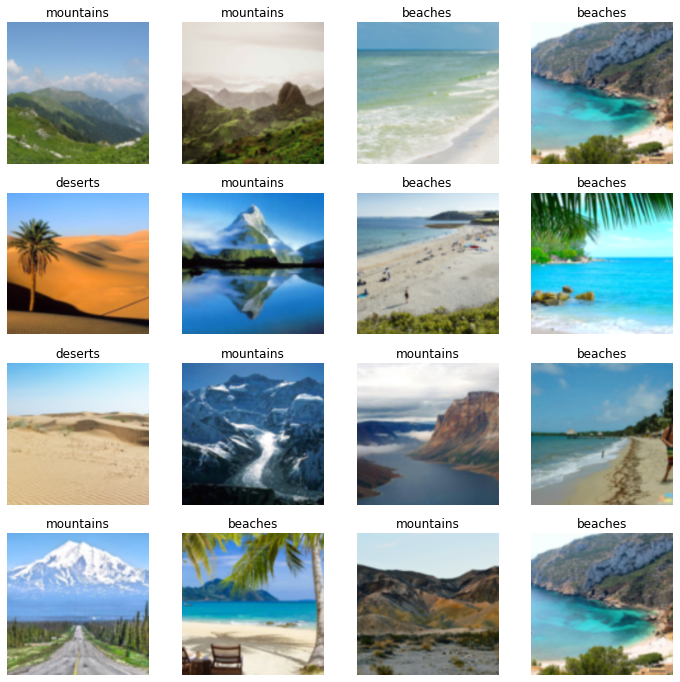

In [11]:
dls.valid.show_batch(max_n=16, nrows=4)

### Train and test model

In [12]:
learn = cnn_learner(dls, resnet34, metrics=error_rate)
learn.fine_tune(10)

epoch,train_loss,valid_loss,error_rate,time
0,1.663548,0.349601,0.132184,00:15


epoch,train_loss,valid_loss,error_rate,time
0,0.474820,0.243194,0.068966,00:15
1,0.415943,0.224505,0.063218,00:14
2,0.356507,0.246729,0.068966,00:16
3,0.292727,0.182838,0.057471,00:14
4,0.239643,0.181488,0.051724,00:14
5,0.198739,0.176259,0.057471,00:15
6,0.164596,0.178066,0.057471,00:15
7,0.147044,0.203489,0.045977,00:15
8,0.129106,0.201229,0.051724,00:14
9,0.114304,0.198920,0.051724,00:15


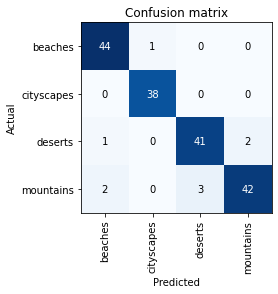

In [13]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

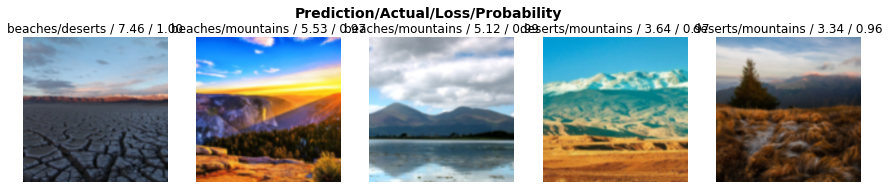

In [14]:
interp.plot_top_losses(5, nrows=1)

Removing faulty images

In [15]:
cleaner = ImageClassifierCleaner(learn)
cleaner

In [16]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

Final training

In [17]:
learn.fine_tune(5)

epoch,train_loss,valid_loss,error_rate,time
0,0.045218,0.182921,0.045977,00:13


epoch,train_loss,valid_loss,error_rate,time
0,0.029451,0.164761,0.057471,00:14
1,0.036900,0.352151,0.063218,00:14
2,0.040490,0.375781,0.057471,00:16
3,0.046770,0.280784,0.040230,00:15
4,0.049075,0.254048,0.040230,00:15


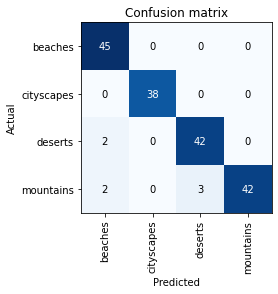

In [18]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

### Exporting model

In [21]:
learn.export()